In [1]:
!pip install matplotlib
!pip install plotly
!pip install --upgrade nbformat

Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from mpl_toolkits.mplot3d import Axes3D
import plotly.graph_objects as go

In [24]:
def plot_reward(reward_fn):
    # Generate a grid of points in the velocity-distance space
    # velocities = np.linspace(0, 10, 500) # replace 0 and 10 with the bounds of your velocity
    # distances = np.linspace(0, 10, 500) # replace 0 and 10 with the bounds of your distance
    velocities = np.linspace(0, 1, 500) # replace 0 and 10 with the bounds of your velocity
    distances = np.linspace(0, 1, 500) # replace 0 and 10 with the bounds of your distance
    V, D = np.meshgrid(velocities, distances)

    # Calculate the reward at each point in the grid
    # R = reward_fn(V, D)
    R = reward_fn(D, V)

    # Create a color plot
    plt.figure(figsize=(10, 7))
    # plt.pcolormesh(V, D, R, cmap='viridis')
    # cmap = colors.LinearSegmentedColormap.from_list("", ["red","blue","green"])
    # cmap = colors.LinearSegmentedColormap.from_list("", ["red","white","green"])

    cmap = colors.LinearSegmentedColormap.from_list("", ["blue","white","red"])
    # plt.pcolormesh(V, D, R, cmap=cmap)
    # plt.colorbar(label='Reward')
    
    # colorbar has range -1 to +1
    # cmap = colors.LinearSegmentedColormap.from_list("", ["red","white","green"])
    plt.pcolormesh(V, D, R, cmap=cmap, vmin=-1, vmax=1)

    plt.xlabel('Distance')
    plt.ylabel('Velocity')
    plt.title('Reward Function')
    plt.show()
    


In [3]:
def plot_reward(reward_fn):
    # Generate a grid of points in the velocity-distance space
    velocities = np.linspace(0, 1, 500)
    distances = np.linspace(0, 1, 500)
    V, D = np.meshgrid(velocities, distances)

    # Calculate the reward at each point in the grid
    R = reward_fn(D, V)

    # Create a 3D plot
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(V, D, R, cmap='viridis', edgecolor='none', vmin=-1, vmax=1)

    ax.set_xlabel('Distance')
    ax.set_ylabel('Velocity')
    ax.set_zlabel('Reward')
    ax.set_title('Reward Function')

    # Add a color bar which maps values to colors
    fig.colorbar(surf, shrink=0.5, aspect=5)

    plt.show()


In [9]:
def plot_reward(reward_fn):
    # Generate a grid of points in the velocity-distance space
    velocities = np.linspace(0, 1, 500)
    distances = np.linspace(0, 1, 500)
    V, D = np.meshgrid(velocities, distances)

    # Calculate the reward at each point in the grid
    R = reward_fn(D, V)

    # Create a 3D plot
    colorscale = [[0, 'red'], [0.5, 'white'], [1, 'green']] # custom colorscale
    # fig = go.Figure(data=[go.Surface(z=R, x=V, y=D, colorscale='Viridis', cmin=-1, cmax=1)])
    fig = go.Figure(data=[go.Surface(z=R, x=V, y=D, colorscale=colorscale, cmin=-1, cmax=1)])
    
    fig.update_layout(title='Reward Function', autosize=False,
                      width=500, height=500,
                      margin=dict(l=65, r=50, b=65, t=90))
    fig.update_layout(scene = dict(
                    xaxis_title='Distance',
                    yaxis_title='Velocity',
                    zaxis_title='Reward'))

    fig.show()


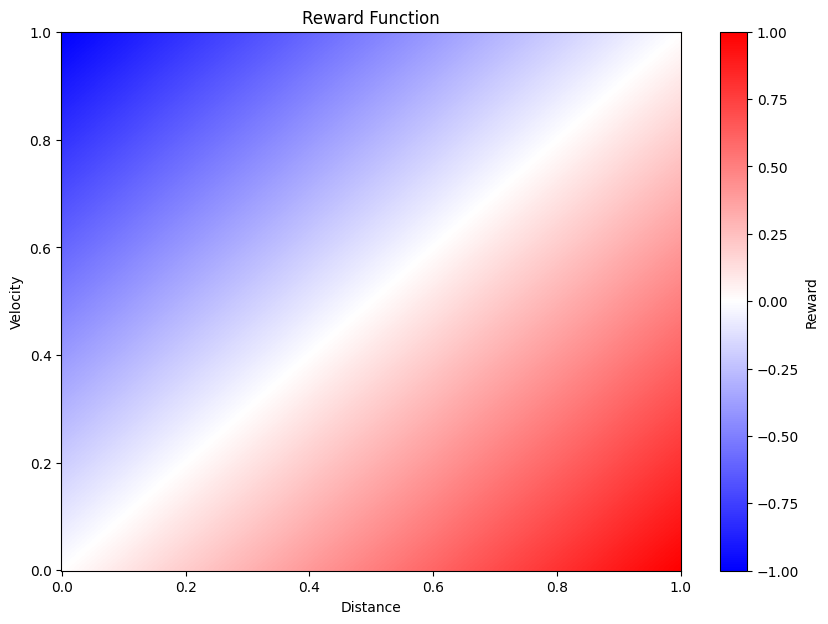

In [24]:
# Define the reward function
def reward(velocity, distance):
    return velocity - distance # replace this with your reward function

plot_reward(reward)

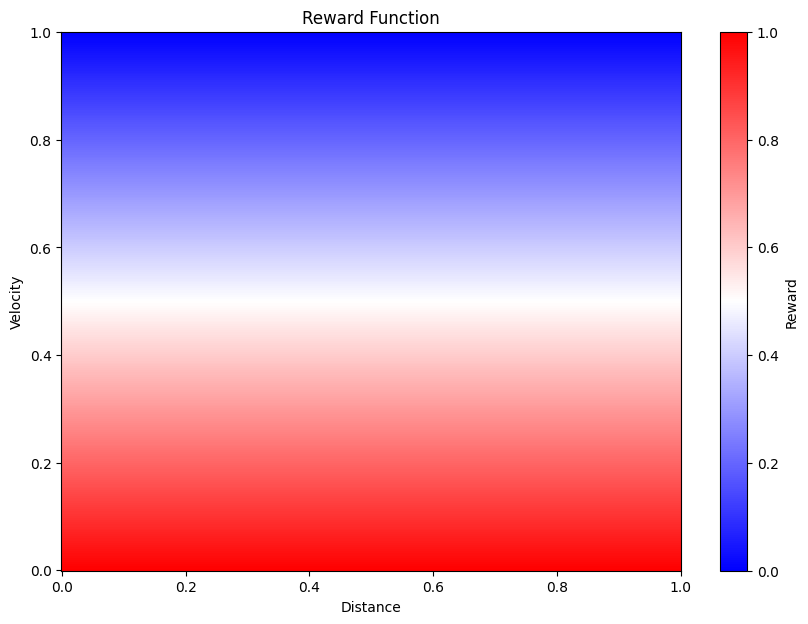

In [30]:
# Define the reward function
def reward(velocity, distance):
    # return 1 - distance # replace this with your reward function
    # 1 - distance^0.4
    return 1 - distance

plot_reward(reward)

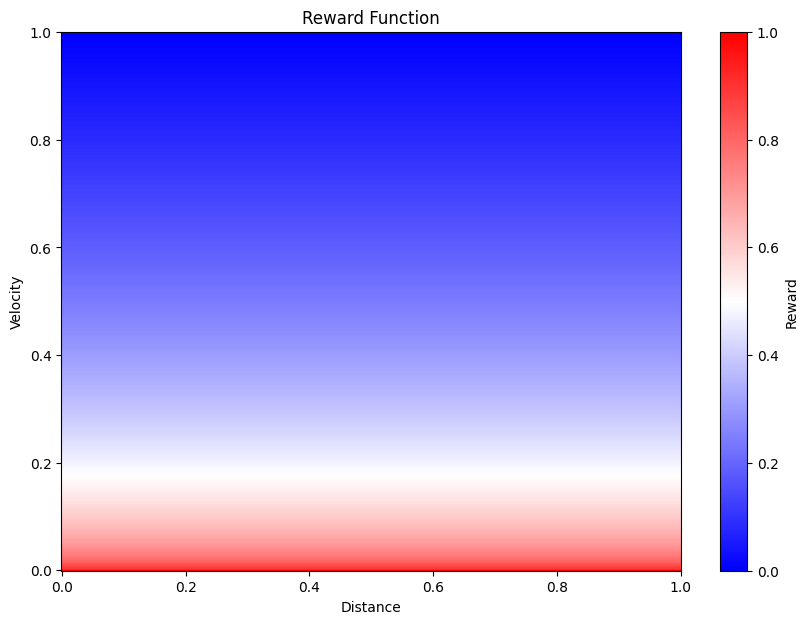

In [25]:
# Define the reward function
def reward(velocity, distance):
    # return 1 - distance # replace this with your reward function
    # 1 - distance^0.4
    return 1 - np.power(distance, 0.4)

plot_reward(reward)

In [33]:
# Define the reward function
def reward(velocity: float, distance: float) -> float:
    # return 1 - distance # replace this with your reward function
    # 1 - distance^0.4
    has_landed = distance < 0.1
    too_fast = velocity < 0.1
    if has_landed:
        return -1 if too_fast else 1
    return 1 - np.power(distance, 0.4)

plot_reward(reward)

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

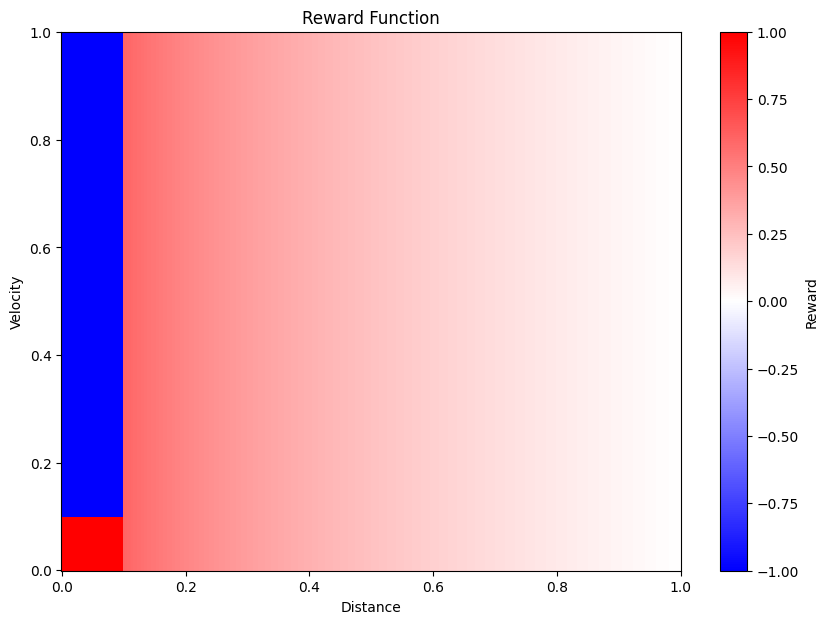

In [8]:
def reward_single(velocity: float, distance: float) -> float:
# def reward_single(distance: float, velocity: float) -> float:
    # return 1 - distance # replace this with your reward function
    # 1 - distance^0.4
    has_landed = distance < 0.1
    too_fast = velocity > 0.1
    if has_landed:
        return -1 if too_fast else 1
    return 1 - np.power(distance, 0.4)

def reward(velocity: np.ndarray, distance: np.ndarray) -> np.ndarray:
    # iterate over all the velocities and distances
    # and calculate the reward for each one
    rewards = []
    for v, d in zip(velocity.flatten(), distance.flatten()):
        rewards.append(reward_single(v, d))
    return np.array(rewards).reshape(velocity.shape)

plot_reward(reward)

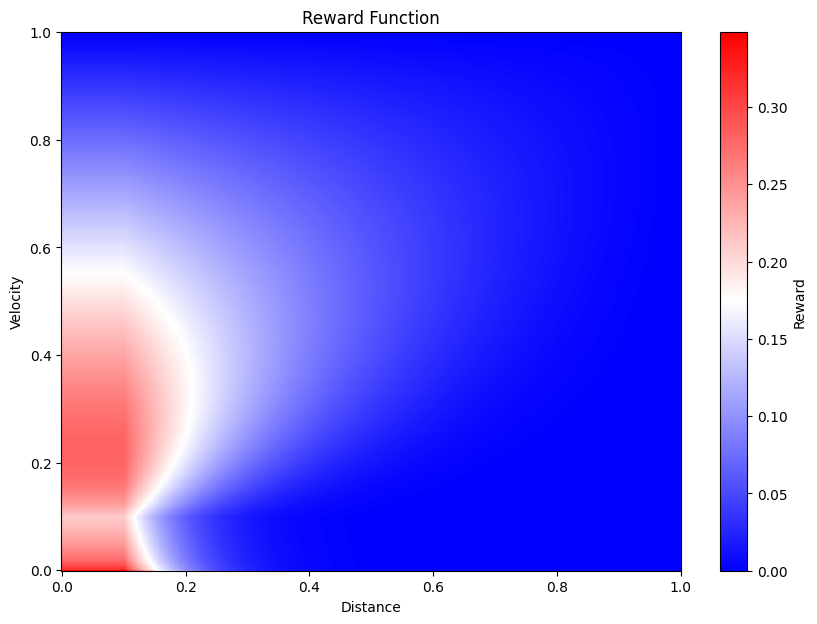

In [27]:
# Define the reward function
def reward(velocity: float, distance: float) -> float:
    # dist_reward = 1 - distance^0.4
    # vel_discount = (1 - max(velocity, 0.1))^(1/max(distance, 0.1))
    # reward = dist_reward * vel_discount
    # rewrite to python
    dist_reward = 1 - np.power(distance, 0.4)
    vel_discount = np.power(1 - np.maximum(velocity, 0.1), 1/np.maximum(distance, 0.1))
    reward = dist_reward * vel_discount
    return reward

plot_reward(reward)

In [10]:
def reward_single(velocity: float, distance: float) -> float:
    has_landed = distance < 0.1
    too_fast = velocity > 0.1
    if has_landed:
        return -1 if too_fast else 1
    # return 1 - np.power(distance, 0.4)
    dist_reward = 1 - np.power(distance, 0.4)
    vel_discount = np.power(1 - np.maximum(velocity, 0.1), 1/np.maximum(distance, 0.1))
    reward = dist_reward * vel_discount
    return reward

def reward(velocity: np.ndarray, distance: np.ndarray) -> np.ndarray:
    rewards = []
    for v, d in zip(velocity.flatten(), distance.flatten()):
        rewards.append(reward_single(v, d))
    return np.array(rewards).reshape(velocity.shape)

plot_reward(reward)

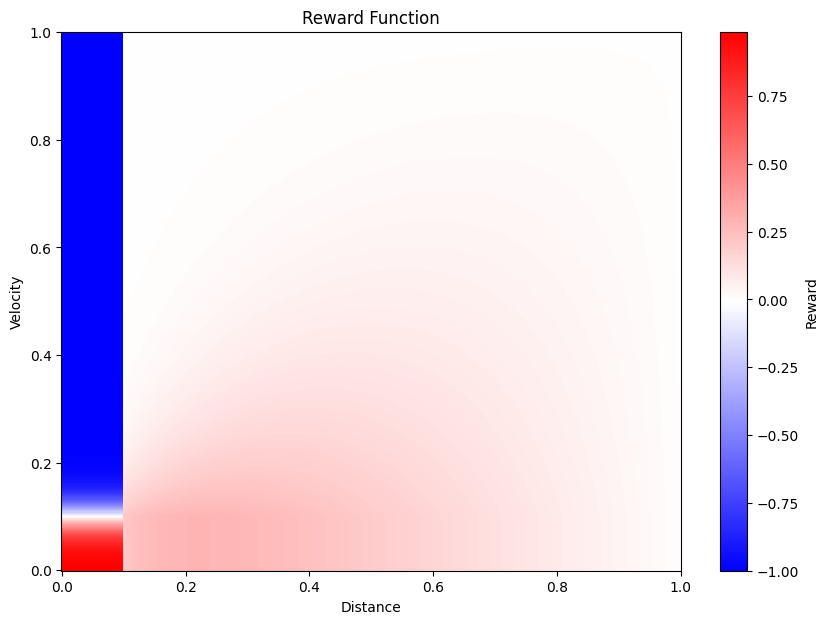

In [12]:
def reward_single(velocity: float, distance: float) -> float:
    def sigmoid(x: float) -> float:
        return 1 / (1 + np.exp(-x))

    landing_transition = sigmoid((0.1 - distance) * 50)  # Multiply by a factor to adjust the transition sharpness
    speed_transition = sigmoid((velocity - 0.1) * 50)

    has_landed = landing_transition
    too_fast = speed_transition
    if has_landed >= 0.5:
        return -1 * too_fast + (1 - too_fast)

    dist_reward = 1 - np.power(distance, 0.4)
    vel_discount = np.power(1 - np.maximum(velocity, 0.1), 1/np.maximum(distance, 0.1))
    reward = dist_reward * vel_discount
    return reward

def reward(velocity: np.ndarray, distance: np.ndarray) -> np.ndarray:
    rewards = []
    for v, d in zip(velocity.flatten(), distance.flatten()):
        rewards.append(reward_single(v, d))
    return np.array(rewards).reshape(velocity.shape)

plot_reward(reward)

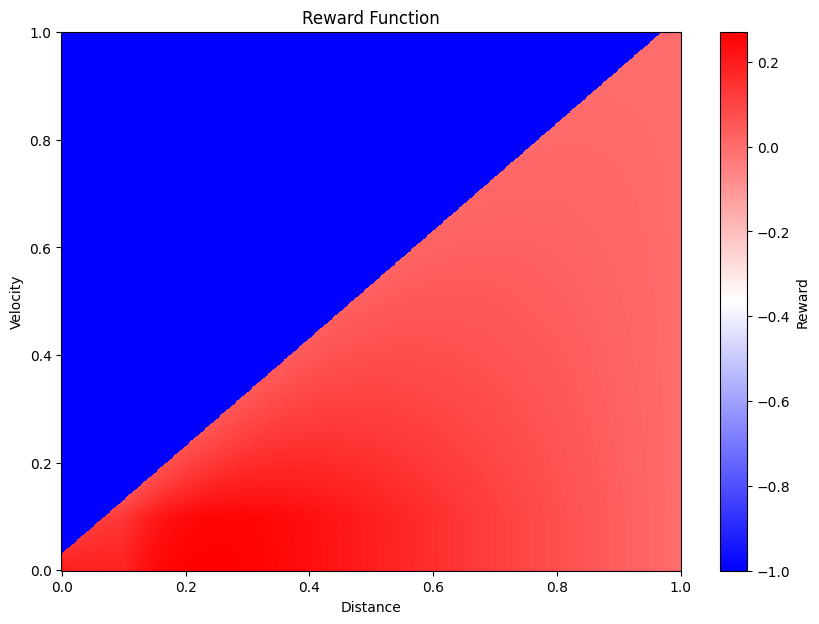

In [15]:
def reward_single(velocity: float, distance: float) -> float:
    crash_distance_threshold = 0.1  # Below this distance, consider it a crash
    crash_velocity_threshold = 0.1  # Above this velocity, consider it a crash

    # Compute indicators that are zero when far from crash, and near 1 when close to crash
    crash_distance_indicator = np.exp(-distance / crash_distance_threshold)
    crash_velocity_indicator = np.exp(velocity / crash_velocity_threshold - 1)

    crash_indicator = crash_distance_indicator * crash_velocity_indicator

    if crash_indicator > 0.5:  # Crash threshold
        return -1

    dist_reward = 1 - np.power(distance, 0.4)
    vel_discount = np.power(1 - np.maximum(velocity, 0.1), 1/np.maximum(distance, 0.1))
    reward = dist_reward * vel_discount

    # You may want to reduce the reward as we approach the crash condition
    reward *= (1 - crash_indicator)

    return reward


def reward(velocity: np.ndarray, distance: np.ndarray) -> np.ndarray:
    rewards = []
    for v, d in zip(velocity.flatten(), distance.flatten()):
        rewards.append(reward_single(v, d))
    return np.array(rewards).reshape(velocity.shape)

plot_reward(reward)

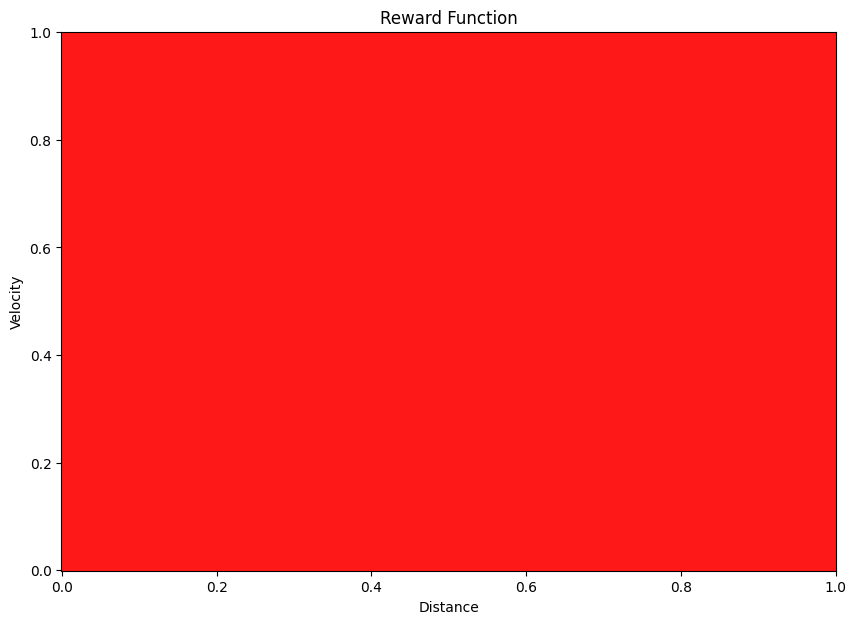

In [25]:
def reward_single(velocity: float, distance: float) -> float:
    crash_distance_threshold = 0.1  # Below this distance, consider it a crash
    crash_velocity_threshold = 0.1  # Above this velocity, consider it a crash

    # Compute indicators that are zero when far from crash, and near 1 when close to crash
    crash_distance_indicator = np.exp(-distance / crash_distance_threshold)
    crash_velocity_indicator = np.exp(velocity / crash_velocity_threshold - 1)

    crash_indicator = crash_distance_indicator * crash_velocity_indicator

    # return 1 * crash_indicator
    # return crash_distance_indicator
    return 1 - crash_velocity_threshold


def reward(velocity: np.ndarray, distance: np.ndarray) -> np.ndarray:
    rewards = []
    for v, d in zip(velocity.flatten(), distance.flatten()):
        rewards.append(reward_single(v, d))
    return np.array(rewards).reshape(velocity.shape)

plot_reward(reward)